In [74]:
# import numpy as np
# import pandas as pd

# import seaborn as sns
# import matplotlib.pyplot as plt

# # Import nltk package (Natural Language Toolkit)
# import nltk
# from nltk.tokenize import word_tokenize
# from nltk.corpus import stopwords

# import warnings
# warnings.filterwarnings('ignore')

# # scikit-learn imports
# from sklearn.model_selection import train_test_split
# from sklearn.svm import SVC
# from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
# from sklearn.metrics import classification_report, precision_recall_fscore_support

# From Example Code  https://github.com/Swathiu/Detecting-Fake-Reviews/blob/master/Deception_Detection.py
import sqlite3
import pandas as pd
import numpy as np
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from datetime import datetime
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from time import time
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, pairwise_distances
from sklearn.metrics import confusion_matrix
from collections import OrderedDict
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

In [2]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', 50) 

In [3]:
file_path = "C:/Users/tsaie/OneDrive/Desktop/000 Resumes & Projects/# Projects/DS3 Fake Amazon Reviews/Dataset/"
apparel = pd.read_csv(file_path + 'amazon_reviews_us_Apparel_v1_00.tsv.gz', compression='gzip', header=0, sep='\t', quotechar='"', error_bad_lines=False, warn_bad_lines=False, nrows=10_000)
# electronics = pd.read_csv(file_path + 'amazon_reviews_us_Apparel_v1_00.tsv.gz', compression='gzip', header=0, sep='\t', quotechar='"', error_bad_lines=False, warn_bad_lines=False)
apparel

,marketplace,customer_id,review_id,product_id,product_parent,product_title,product_category,star_rating,helpful_votes,total_votes,vine,verified_purchase,review_headline,review_body,review_date
0,US,32158956,R1KKOXHNI8MSXU,B01KL6O72Y,24485154,Easy Tool Stainless Steel Fruit Pineapple Core...,Apparel,4,0,0,N,Y,★ THESE REALLY DO WORK GREAT WITH SOME TWEAKING ★,"These Really Do Work Great, But You Do Need To...",2013-01-14
1,US,2714559,R26SP2OPDK4HT7,B01ID3ZS5W,363128556,V28 Women Cowl Neck Knit Stretchable Elasticit...,Apparel,5,1,2,N,Y,Favorite for winter. Very warm!,I love this dress. Absolute favorite for winte...,2014-03-04
2,US,12608825,RWQEDYAX373I1,B01I497BGY,811958549,James Fiallo Men's 12-Pairs Low Cut Athletic S...,Apparel,5,0,0,N,Y,Great Socks for the money.,"Nice socks, great colors, just enough support ...",2015-07-12
3,US,25482800,R231YI7R4GPF6J,B01HDXFZK6,692205728,Belfry Gangster 100% Wool Stain-Resistant Crus...,Apparel,5,0,0,N,Y,Slick hat!,"I bought this for my husband and WOW, this is ...",2015-06-03
4,US,9310286,R3KO3W45DD0L1K,B01G6MBEBY,431150422,JAEDEN Women's Beaded Spaghetti Straps Sexy Lo...,Apparel,5,0,0,N,Y,I would do it again!,Perfect dress and the customer service was awe...,2015-06-12
5,US,26631939,R1C4QH63NFL5NJ,B01FWRXN0Y,366144407,Levi's Boys' 514 Straight Fit Jeans,Apparel,5,0,0,N,Y,Five Stars,Excellent for my 6 feet skinny 15 years old boy.,2014-04-22
6,US,48785098,R2GP65O1U9N7BP,B01EXNH1HE,786052021,Minimalist Wallet & Credit Card Holder Men wit...,Apparel,5,0,0,N,Y,Love it!,Raw is the only way to go! Absolutely love thi...,2015-07-28
7,US,39548589,R3O29CT5MQQ3XQ,B01E7OL09O,108920964,Harriton Men's Barbados Textured Camp Shirt,Apparel,4,0,0,N,Y,Three Stars,A bit large.,2015-07-10
8,US,29355866,R1ZECD2AA8QFF6,B01DXHX81O,317132458,Jockey Women's Underwear Supersoft Brief - 3 Pack,Apparel,5,0,0,N,Y,Five Stars,Great fit!,2015-08-09
9,US,27477484,R2S79GCF6J89OA,B01DDULIJK,110598191,"Alexander Del Rossa Mens Satin Pajamas, Short ...",Apparel,3,0,0,N,Y,Not my favorite.,"Shirt a bit too long, with heavy hem, which in...",2014-05-24


In [11]:
apparel_small = apparel[['verified_purchase', 'review_body']]
apparel_small

,verified_purchase,review_body
0,Y,these really do work great but you do need to ...
1,Y,i love dress absolute favorite winter heavy ma...
2,Y,nice socks great colors enough support wearing...
3,Y,i bought husband wow slick hat high quality cr...
4,Y,perfect dress customer service awesome
5,Y,excellent 6 feet skinny 15 years old boy
6,Y,raw way go absolutely love wallet will continu...
7,Y,a bit large
8,Y,great fit
9,Y,shirt bit long heavy hem inhibits turning over...


In [86]:
import spacy

def data_cleaning(df):
    print("Cleaning Data")

    # Removing emtpy cells
    df.dropna(inplace=True)

    # Pre-processing Text Reviews
    
    # Remove Stop Words and Remove "br " (HTML line break symbols)
    stop = stopwords.words('english')
    stop += ["br"]
            
    df['review_body'] = df['review_body'].apply(
        lambda x: ' '.join(word for word in x.split() if word not in stop))


    # Remove Punctuations
    tokenizer = RegexpTokenizer(r'\w+')
    df['review_body'] = df['review_body'].apply(
        lambda x: ' '.join(word for word in tokenizer.tokenize(x)))

    # Lowercase Words
    df['review_body'] = df['review_body'].apply(
        lambda x: x.lower())
    

    # Lemmatization using .lemma_
    nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
    df['review_body'] = df['review_body'].apply(
        lambda x: ' '.join(token.lemma_ for token in nlp(x)))
    
    print("Data Cleaning Complete")
    return df

In [87]:
apparel_cleaned = data_cleaning(apparel_small)
apparel_cleaned

Cleaning Data


<ipython-input-86-deed12fc2b24>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(inplace=True)
<ipython-input-86-deed12fc2b24>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['review_body'] = df['review_body'].apply(
<ipython-input-86-deed12fc2b24>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['review_

Data Cleaning Complete


,verified_purchase,review_body,bigrams
0,Y,really work great need know thing use mine yea...,"[(really, work), (work, great), (great, need),..."
1,Y,love dress absolute favorite winter heavy mate...,"[(love, dress), (dress, absolute), (absolute, ..."
2,Y,nice sock great color enough support wear good...,"[(nice, socks), (socks, great), (great, colors..."
3,Y,buy husband wow slick hat high quality craftsm...,"[(bought, husband), (husband, wow), (wow, slic..."
4,Y,perfect dress customer service awesome,"[(perfect, dress), (dress, customer), (custome..."
5,Y,excellent 6 foot skinny 15 year old boy,"[(excellent, 6), (6, feet), (feet, skinny), (s..."
6,Y,raw way go absolutely love wallet continue buy...,"[(raw, way), (way, go), (go, absolutely), (abs..."
7,Y,bit large,"[(bit, large)]"
8,Y,great fit,"[(great, fit)]"
9,Y,shirt bit long heavy hem inhibit turn cut bott...,"[(shirt, bit), (bit, long), (long, heavy), (he..."


In [88]:
# https://stackoverflow.com/questions/48331315/how-to-extract-all-the-ngrams-from-a-text-dataframe-column-in-different-order-in

from collections import Counter
from nltk import ngrams
from itertools import chain

def find_ngrams(input_list, n):
    return list(zip(*[input_list[i:] for i in range(n)]))

In [89]:
apparel_cleaned['bigrams'] = apparel_cleaned['review_body'].map(lambda x: find_ngrams(x.split(" "), 2))
apparel_cleaned

<ipython-input-89-703355cec150>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  apparel_cleaned['bigrams'] = apparel_cleaned['review_body'].map(lambda x: find_ngrams(x.split(" "), 2))


,verified_purchase,review_body,bigrams
0,Y,really work great need know thing use mine yea...,"[(really, work), (work, great), (great, need),..."
1,Y,love dress absolute favorite winter heavy mate...,"[(love, dress), (dress, absolute), (absolute, ..."
2,Y,nice sock great color enough support wear good...,"[(nice, sock), (sock, great), (great, color), ..."
3,Y,buy husband wow slick hat high quality craftsm...,"[(buy, husband), (husband, wow), (wow, slick),..."
4,Y,perfect dress customer service awesome,"[(perfect, dress), (dress, customer), (custome..."
5,Y,excellent 6 foot skinny 15 year old boy,"[(excellent, 6), (6, foot), (foot, skinny), (s..."
6,Y,raw way go absolutely love wallet continue buy...,"[(raw, way), (way, go), (go, absolutely), (abs..."
7,Y,bit large,"[(bit, large)]"
8,Y,great fit,"[(great, fit)]"
9,Y,shirt bit long heavy hem inhibit turn cut bott...,"[(shirt, bit), (bit, long), (long, heavy), (he..."


In [90]:
apparel_un_verified = apparel_cleaned[apparel_cleaned['verified_purchase'] == 'N']
apparel_verified = apparel_cleaned[apparel_cleaned['verified_purchase'] == 'Y']

apparel_un_verified

,verified_purchase,review_body,bigrams
28,N,second tank order wear often wash well receive...,"[(second, tank), (tank, order), (order, wear),..."
29,N,buy jacket amazon simply bad jacket ever buy b...,"[(buy, jacket), (jacket, amazon), (amazon, sim..."
31,N,great fit love print probably order,"[(great, fit), (fit, love), (love, print), (pr..."
32,N,awesome fit hot style love,"[(awesome, fit), (fit, hot), (hot, style), (st..."
33,N,receive rfid blocking leather wallet first thi...,"[(receive, rfid), (rfid, blocking), (blocking,..."
34,N,love wallet first thing notice soft flexible w...,"[(love, wallet), (wallet, first), (first, thin..."
35,N,size 34b size fit perfectly comfortable feel l...,"[(size, 34b), (34b, size), (size, fit), (fit, ..."
36,N,fine,[]
37,N,super nice comfortable sock get color love tha...,"[(super, nice), (nice, comfortable), (comforta..."
38,N,cute dress please advise cute dress run small ...,"[(cute, dress), (dress, please), (please, advi..."


In [91]:
verified_bigrams = apparel_verified['bigrams'].tolist()
verified_bigrams = list(chain(*verified_bigrams))

verified_bigram_counts = Counter(verified_bigrams)
verified_bigram_counts.most_common(10)

[(('fit', 'perfectly'), 240),
 (('fit', 'great'), 225),
 (('look', 'like'), 217),
 (('fit', 'well'), 210),
 (('good', 'quality'), 183),
 (('fit', 'perfect'), 172),
 (('well', 'make'), 165),
 (('run', 'small'), 163),
 (('order', 'size'), 157),
 (('like', 'picture'), 148)]

In [92]:
un_verified_bigrams = apparel_un_verified['bigrams'].tolist()
un_verified_bigrams = list(chain(*un_verified_bigrams))

un_verified_bigram_counts = Counter(un_verified_bigrams)
un_verified_bigram_counts.most_common(10)

[(('exchange', 'honest'), 447),
 (('receive', 'product'), 356),
 (('honest', 'review'), 340),
 (('unbiased', 'review'), 287),
 (('honest', 'unbiased'), 264),
 (('product', 'discount'), 262),
 (('discount', 'exchange'), 219),
 (('well', 'make'), 174),
 (('discount', 'price'), 153),
 (('fit', 'perfectly'), 148)]

In [25]:
def under_sampling(df):
    print("Under-Sampling Data")
    # Count of Reviews
    print("Verified:", len(df[(df['verified_purchase'] == 'Y')]))
    print("Un-Verified:", len(df[(df['verified_purchase'] == 'N')]))

    sample_size = len(df[(df['verified_purchase'] == 'N')])

    authentic_reviews_df = df[df['verified_purchase'] == 'Y']
    fake_reviews_df = df[df['verified_purchase'] == 'N']

    authentic_reviews_us_df = authentic_reviews_df.sample(sample_size)
    under_sampled_df = pd.concat([authentic_reviews_us_df, fake_reviews_df], axis=0)

    print("Under-Sampled Verified", len(under_sampled_df[(under_sampled_df['verified_purchase'] == 'Y')]))
    print("Under-Sampled Un-Verified", len(under_sampled_df[(under_sampled_df['verified_purchase'] == 'N')]))
    

    # Graph of Data Distribution
    fig, ax = plt.subplots(figsize=(6, 4))
    sns.countplot(x='verified_purchase', data=under_sampled_df)
    plt.title("Count of Reviews")
    plt.show()
    print("Under-Sampling Complete")
    return under_sampled_df

Under-Sampling Data
Verified: 24280
Un-verified: 5708
Under-Sampled Authentic 5708
Under-Sampled Fake 5708


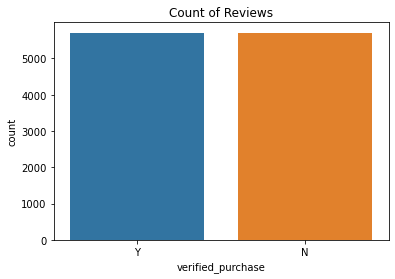

Under-Sampling Complete


,marketplace,customer_id,review_id,product_id,product_parent,product_title,product_category,star_rating,helpful_votes,total_votes,vine,verified_purchase,review_headline,review_body,review_date
16503,US,41295475,R2PK4V60ZMR5MN,B00ZW3IMSC,200991864,LaSuiveur Womens Crop Top Midi Skirt Outfit Tw...,Apparel,4,0,0,N,Y,Four Stars,material thin fits nicely,2015-08-07
27738,US,10423707,R6WB7FRM3RGZ5,B00YRUY604,248829392,MUXXN Women's Off-shoulder Halter Polka Dot Vi...,Apparel,5,1,2,N,Y,Ordered as a gift for my fiance to wear when ...,ordered gift fiance wear weather warm somethin...,2015-07-24
2971,US,27582118,R2Z2YFCUVCCP0Y,B012A3QU7G,644231791,LYZ Women's Girdle Belt Waist Cincher Tummy Co...,Apparel,4,0,0,N,Y,The product is good for the price but it's too...,the product good price big ordered medium feel...,2015-07-22
29996,US,815985,R3AS3GZ2SWOI4T,B00YMGPXKA,761578233,FashionWomen New Womens Deep V-neck Sexy Long ...,Apparel,2,4,7,N,Y,Not happy with this dress at all,first dress even red hot pink not i expected i...,2015-07-02
2906,US,35488454,R2VMTD1SDGU3E6,B012ADNN6C,640132942,ACEVOG Vintage 1950's Floral Spring Garden Par...,Apparel,3,3,3,N,Y,Buy Big,i ll keep har5d return i usually wear medium l...,2015-08-24
15954,US,31106579,R35HBCFIREALCL,B00ZY5O8HW,363698042,Dorzi(TM) Women's Smocked Waist Baggy Bohemian...,Apparel,1,0,0,N,Y,One Star,be sure review size chart material chea looking,2015-08-22
14664,US,11185124,R17134UAH70WI6,B0101M8N14,400962248,Baby Shower Gifts by Fayfaire Boutique | Funny...,Apparel,5,0,0,N,Y,Five Stars,so cute,2015-08-03
15366,US,50217307,R2XWKJRAYU5FAB,B00ZZGLX32,620409741,Vigoss Big Girls' Yummy Stretch Skinny Jeans,Apparel,5,1,2,N,Y,Five Stars,super cute good quality,2015-08-10
23667,US,1986433,R1CKXV755CFLBA,B00Z7ID8L8,519885937,sho sho leggings,Apparel,5,26,27,N,Y,Aztec Leggings (AMAZING!!!!),they super stretchy become see all i love supe...,2015-08-05
18860,US,46642619,R2263D7W8V4XWH,B00ZP6DB3C,206860700,"DIYtshirt Michael Jordan T-Shirt, Custom Men's...",Apparel,3,0,0,N,Y,Nice shirt,somewhat small but nice shirt,2015-08-20


In [27]:
apparel_equal_weight = under_sampling(apparel_cleaned)
apparel_equal_weight


# Ignore the code below for now

In [42]:
def semi_supervised_learning(df, model, algorithm, threshold=0.8, iterations=40):
    df = df.copy()
    df = df[['verified_purchase', 'review_body']]
    df['verified_purchase'] = df['verified_purchase'].apply(lambda x: 1 if x == 'Y' else 0)
    print("Training "+algorithm+" Model")
    labels = df['verified_purchase']

#     df.drop(['marketplace', 'customer_id', 'review_id', 'product_id', 'product_parent', 'product_title', 'product_category', 
#              'star_rating', 'helpful_votes', 'total_votes', 'vine', 'review_headline', 'review_date'], axis=1, inplace=True)

    train_data, test_data, train_label, test_label = train_test_split(df, labels, test_size=0.25, random_state=42)

    test_data_copy = test_data.copy()
    test_label_copy = test_label.copy()

    all_labeled = False

    current_iteration = 0

    # param_grid = {
    #     'n_estimators': [10, 500],
    #     'max_features': ['auto', 'sqrt', 'log2'],
    #     'max_depth': [4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14],
    #     'criterion': ['gini', 'entropy']
    # }
    # grid_clf_acc = GridSearchCV(estimator=model, param_grid=param_grid, cv=5)
    #
    # grid_clf_acc.fit(train_data, train_label)

    pbar = tqdm(total=iterations)

    while not all_labeled and (current_iteration < iterations):
        # print("Before train data length : ", len(train_data))
        # print("Before test data length : ", len(test_data))
        current_iteration += 1
        model.fit(train_data, train_label)

        probabilities = model.predict_proba(test_data)
        pseudo_labels = model.predict(test_data)

        indices = np.argwhere(probabilities > threshold)

        # print("rows above threshold : ", len(indices))
        for item in indices:
            train_data.loc[test_data.index[item[0]]] = test_data.iloc[item[0]]
            train_label.loc[test_data.index[item[0]]] = pseudo_labels[item[0]]
        test_data.drop(test_data.index[indices[:, 0]], inplace=True)
        test_label.drop(test_label.index[indices[:, 0]], inplace=True)
        # print("After train data length : ", len(train_data))
        # print("After test data length : ", len(test_data))
        print("--" * 20)

        if len(test_data) == 0:
            print("Exiting loop")
            all_labeled = True
        pbar.update(1)
    pbar.close()
    predicted_labels = model.predict(test_data_copy)

    # print('Best Params : ', grid_clf_acc.best_params_)
    print(algorithm + ' Model Results')
    print('--' * 20)
    print('Accuracy Score : ' + str(accuracy_score(test_label_copy, predicted_labels)))
    print('Precision Score : ' + str(precision_score(test_label_copy, predicted_labels, pos_label="N")))
    print('Recall Score : ' + str(recall_score(test_label_copy, predicted_labels, pos_label="N")))
    print('F1 Score : ' + str(f1_score(test_label_copy, predicted_labels, pos_label="N")))
    print('Confusion Matrix : \n' + str(confusion_matrix(test_label_copy, predicted_labels)))
    plot_confusion_matrix(test_label_copy, predicted_labels, classes=['Y', 'N'],
                          title=algorithm + ' Confusion Matrix').show()


def plot_confusion_matrix(y_true, y_pred, classes, title=None, cmap=plt.cm.Blues):
    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           xticklabels=classes,
           yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()

    return plt


In [43]:
start_time = time()
rf = RandomForestClassifier(random_state=42, criterion='entropy', max_depth=14, max_features='auto', n_estimators=500)
nb = GaussianNB()

semi_supervised_learning(apparel_equal_weight, model=rf, threshold=0.7, iterations=15, algorithm='Random Forest')
# semi_supervised_learning(apparel_equal_weight, model=nb, threshold=0.7, iterations=15, algorithm='Naive Bayes')
end_time = time()

print("Time taken : ", end_time - start_time)








  0%|          | 0/15 [00:00<?, ?it/s]

Training Random Forest Model


ValueError: could not convert string to float: 'i tall fat stomach this actually looked okay i tall waste high i sent back really great dress price'